# Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
import os
import torch
import tqdm
import matplotlib.pyplot as plt
os.chdir("drive/MyDrive/")
os.listdir()

['Colab Notebooks', '.ipynb_checkpoints', 'Learn_JAX', 'PytorchThesis']

In [3]:
!nvidia-smi

Mon Jul 12 19:04:32 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Git Clone if need be

## If we want to remove exisiting code

In [ ]:
!rm -r PytorchThesis/

In [ ]:
os.listdir()

['Colab Notebooks', '.ipynb_checkpoints', 'Learn_JAX']

## Git Clone

In [ ]:
!git clone https://github.com/lollcat/Boltzmann-Generators.git --branch ToyProblems --single-branch PytorchThesis

Cloning into 'PytorchThesis'...
remote: Enumerating objects: 1369, done.
remote: Counting objects: 100% (89/89), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 1369 (delta 41), reused 59 (delta 22), pack-reused 1280
Receiving objects: 100% (1369/1369), 178.51 MiB | 19.80 MiB/s, done.
Resolving deltas: 100% (788/788), done.
Checking out files: 100% (277/277), done.


# Setup Dir

In [4]:
os.listdir()

['Colab Notebooks', '.ipynb_checkpoints', 'Learn_JAX', 'PytorchThesis']

In [5]:
os.chdir("PytorchThesis")
os.listdir()

['.git',
 '.gitignore',
 '.idea',
 'AIS_train',
 'FittedModels',
 'ImportanceSampling',
 'LikelihoodTrain',
 'Miscellaneous',
 'NormalisingFlow',
 'Notebooks',
 'README.md',
 'TargetDistributions',
 'Utils']

# Let's Go

## Setup

In [6]:
from TargetDistributions.DoubleWell import ManyWellEnergy
from FittedModels.utils.plotting_utils import plot_samples_vs_contours_many_well

In [7]:
from FittedModels.Models.FlowModel import FlowModel
from AIS_train.train_AIS import AIS_trainer
from ImportanceSampling.VanillaImportanceSampler import VanillaImportanceSampling
from FittedModels.utils.plotting_utils import plot_history, plot_distributions, plot_samples

import matplotlib.pyplot as plt
import torch
from Utils.plotting_utils import plot_func2D, plot_distribution
from Utils.numerical_utils import MC_estimate_true_expectation
from Utils.numerical_utils import quadratic_function as expectation_function
torch.set_default_dtype(torch.float64)

def plotter(*args, **kwargs):
    # wrap plotting function like this so it displays during training
    plot_samples_vs_contours_many_well(*args, **kwargs)
    plt.show()

In [8]:
dim = 16
target = ManyWellEnergy(dim=dim, a=-0.5, b=-6)

In [9]:
n_samples_expectation = int(1e5)
n_samples=int(1e4)

In [10]:
learnt_sampler = FlowModel(x_dim=dim, scaling_factor=2.0, flow_type="ReverseIAF_MIX", n_flow_steps=20, nodes_per_x=1.5)
tester = AIS_trainer(target, learnt_sampler, loss_type=False, n_distributions=30, n_steps_transition_operator=1,
                    step_size=1.0, transition_operator="HMC", learnt_dist_kwargs={"lr": 1e-4},
                     loss_type_2="alpha_2",  train_AIS_params=True, inner_loop_steps=5)

# Initial Info if we are interested

In [ ]:
learnt_sampler = FlowModel(x_dim=dim, scaling_factor=2.0, flow_type="ReverseIAF", n_flow_steps=1)
vanilla_IS = VanillaImportanceSampling(sampling_distribution=learnt_sampler, target_distribution=target)
with torch.no_grad():
    expectation_vanilla, info_dict_vanilla = \
    vanilla_IS.calculate_expectation(n_samples_expectation, expectation_function=expectation_function)
    print(f"ESS is {info_dict_vanilla['effective_sample_size']/n_samples_expectation}, \
          var is {torch.var(info_dict_vanilla['normalised_sampling_weights'])}")

ESS is 1.038354547294124e-05,           var is 9.63061816464297e-06


In [ ]:
expectation_before, info_dict_before = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3))
print(info_dict_before['effective_sample_size'].item() / n_samples_expectation)
#torch.cuda.empty_cache()

3.555649255326544e-05


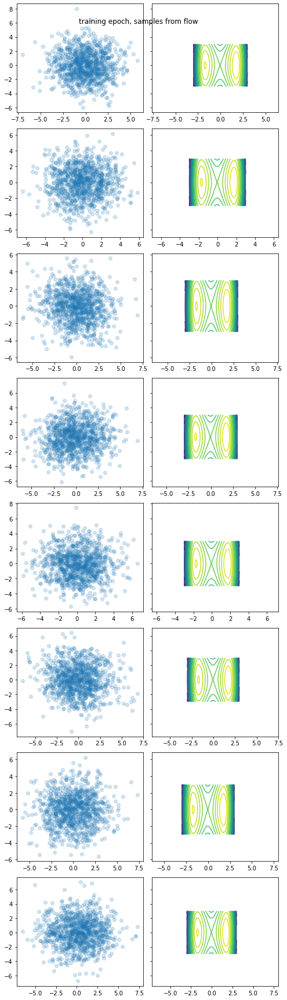

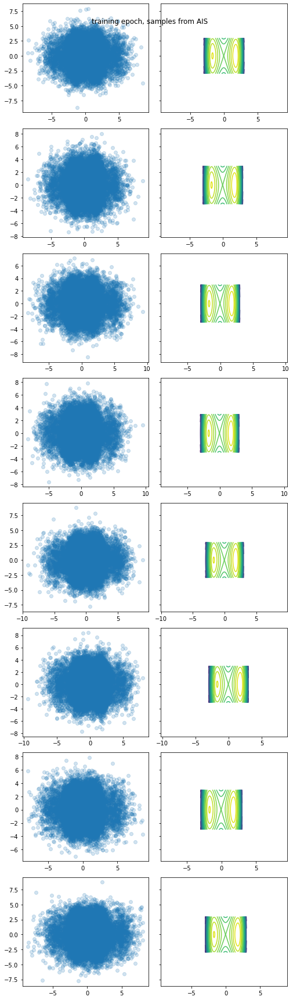

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict_before["samples"])

# Run First iter

  0%|          | 0/1500 [00:00<?, ?it/s]/content/drive/MyDrive/PytorchThesis/ImportanceSampling/SamplingAlgorithms/HamiltonianMonteCarlo.py:120: FutureWarning: Non-finite norm encountered in torch.nn.utils.clip_grad_norm_; continuing anyway. Note that the default behavior will change in a future release to error out if a non-finite total norm is encountered. At that point, setting error_if_nonfinite=false will be required to retain the old behavior.
  grad_norm = torch.nn.utils.clip_grad_norm_(self.parameters(), 1)


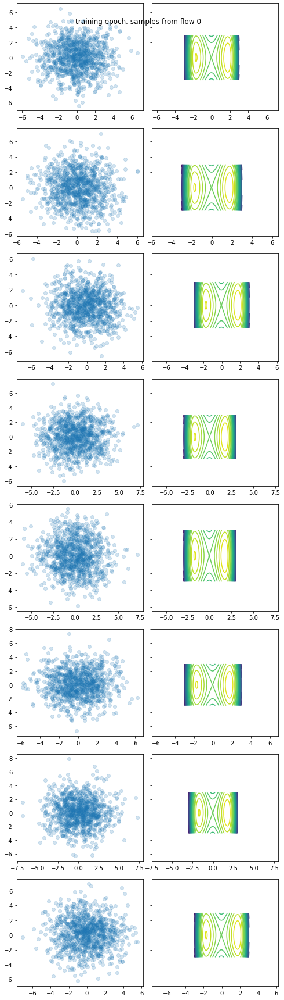

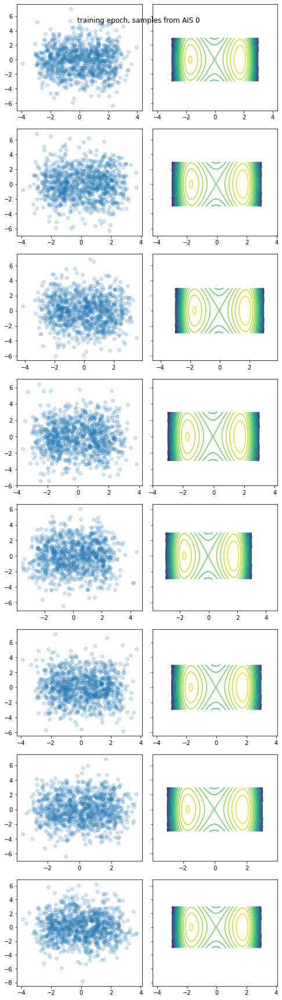

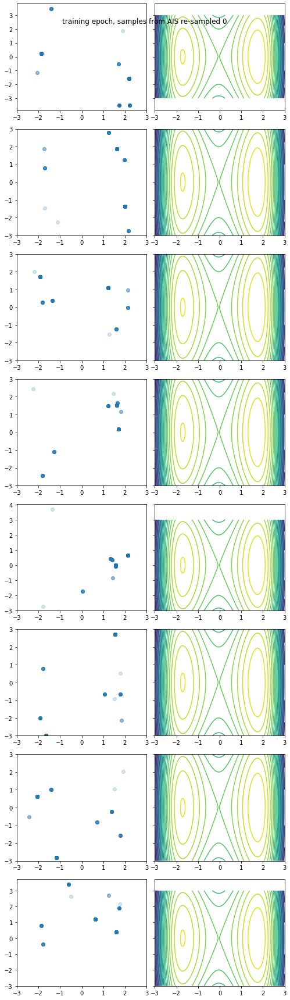

  0%|          | 1/1500 [00:17<7:25:52, 17.85s/it]/content/drive/MyDrive/PytorchThesis/ImportanceSampling/SamplingAlgorithms/HamiltonianMonteCarlo.py:120: FutureWarning: Non-finite norm encountered in torch.nn.utils.clip_grad_norm_; continuing anyway. Note that the default behavior will change in a future release to error out if a non-finite total norm is encountered. At that point, setting error_if_nonfinite=false will be required to retain the old behavior.
  grad_norm = torch.nn.utils.clip_grad_norm_(self.parameters(), 1)
loss: 186.18528898276648,   log_p_x_post_AIS 59.63157639155919, ESS 0.008785783365768612:   5%|▌         | 75/1500 [13:11<4:04:51, 10.31s/it]

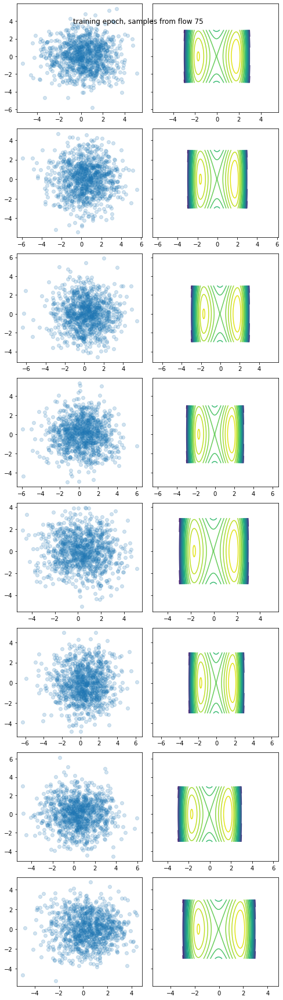

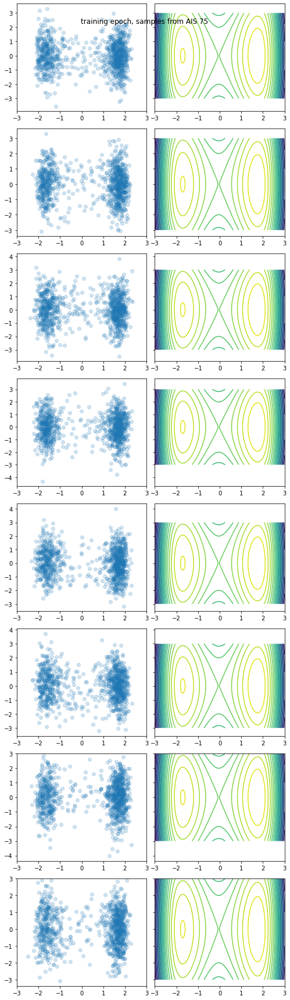

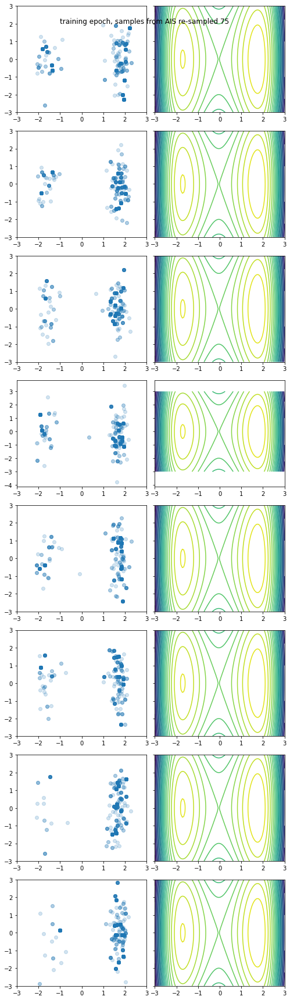

loss: 184.44081609706902,   log_p_x_post_AIS 60.866494440799435, ESS 0.01725542248170869:  10%|█         | 150/1500 [26:13<3:51:16, 10.28s/it]

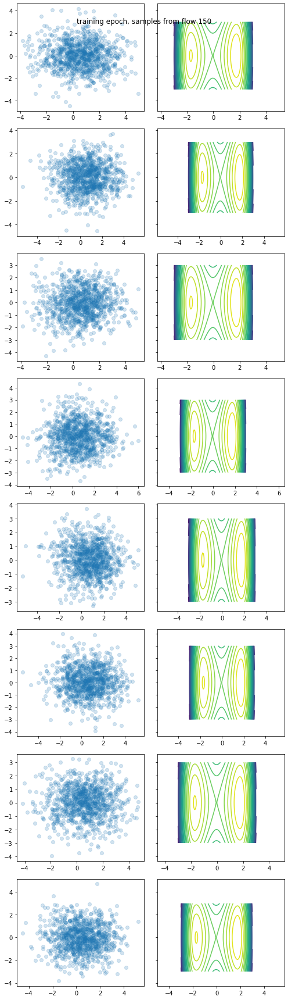

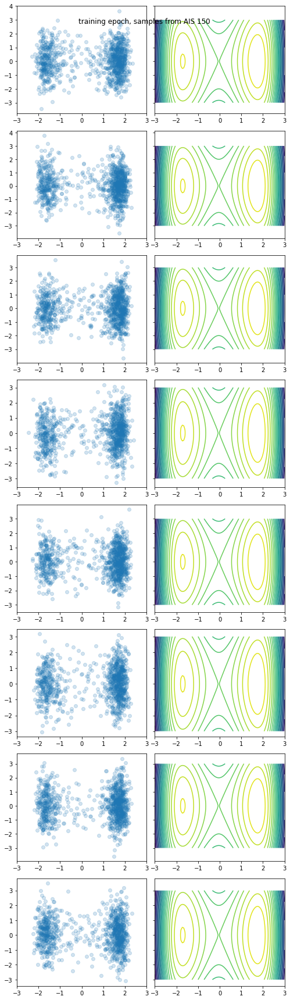

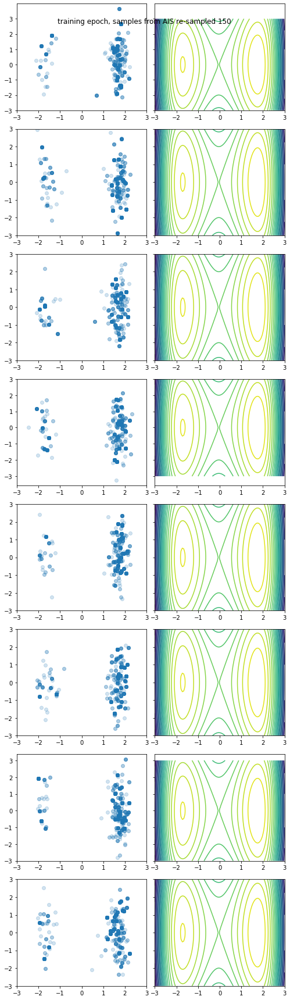

loss: 183.9799646607001,   log_p_x_post_AIS 61.51758958621734, ESS 0.02357211272301206:  15%|█▌        | 225/1500 [39:19<3:41:08, 10.41s/it]   

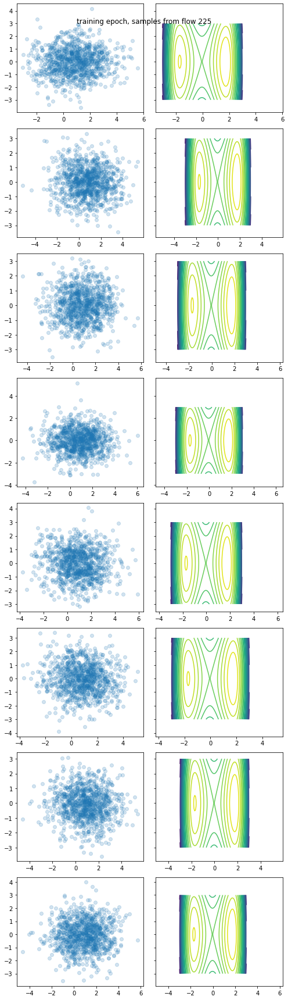

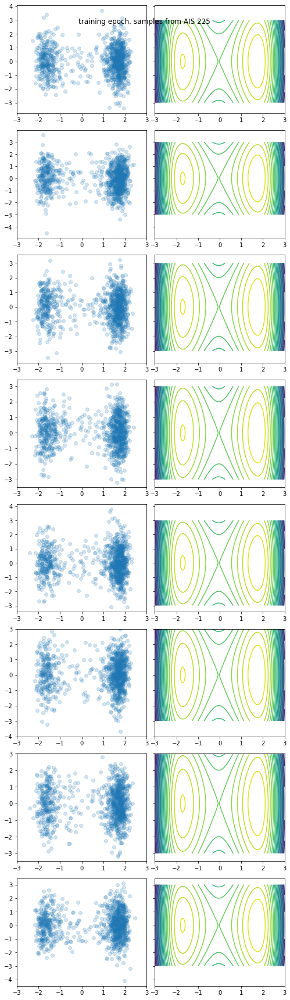

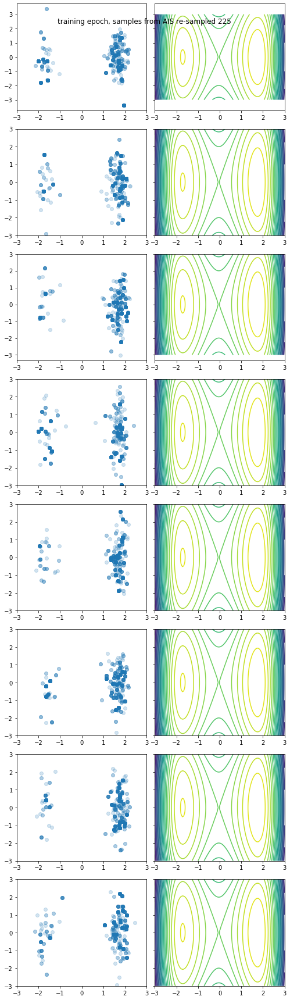

loss: 183.87934606601385,   log_p_x_post_AIS 62.415508302296764, ESS 0.025741106584693595:  20%|██        | 300/1500 [52:30<3:25:23, 10.27s/it]

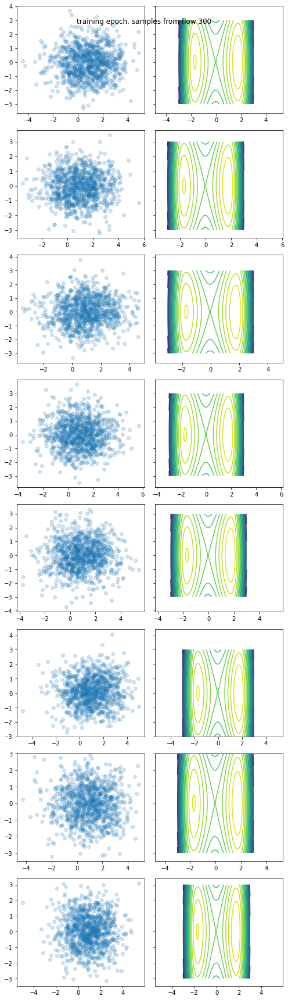

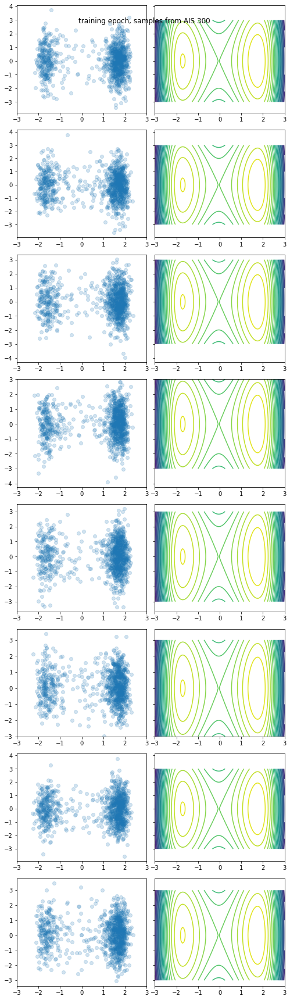

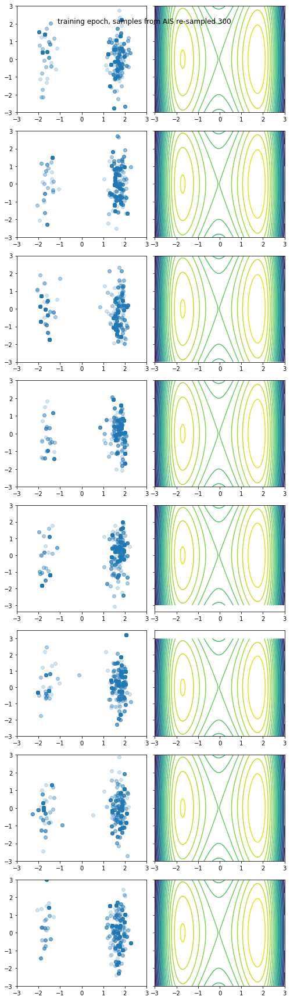

loss: 183.67737830220912,   log_p_x_post_AIS 62.80355526117752, ESS 0.028174584391563604:  25%|██▌       | 375/1500 [1:05:30<3:12:37, 10.27s/it]

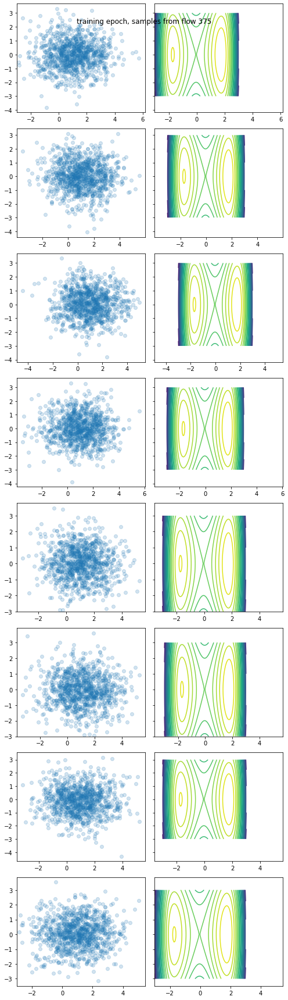

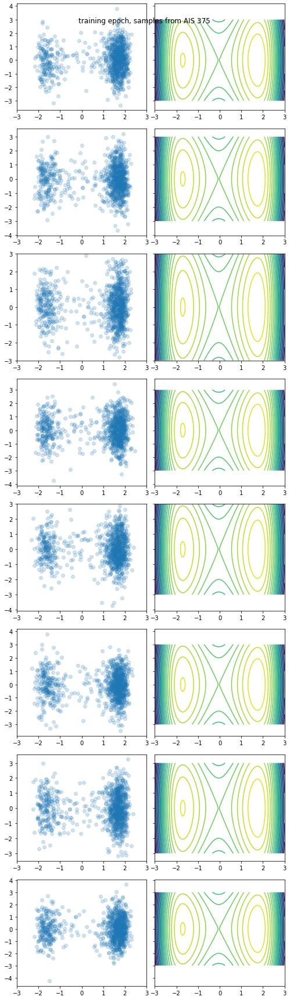

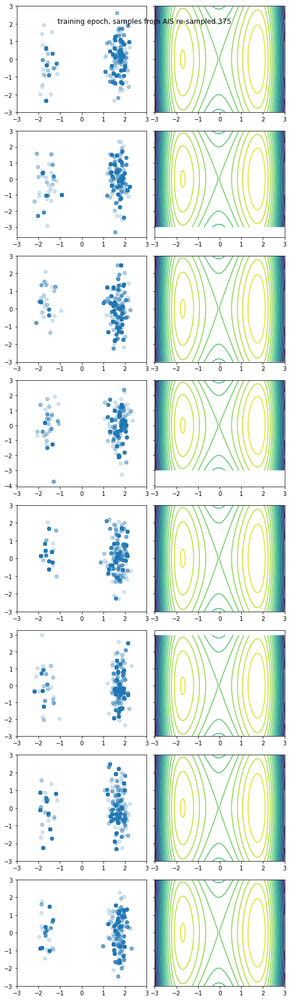

loss: 184.01576047952676,   log_p_x_post_AIS 63.01093551899164, ESS 0.02169000071280978:  30%|███       | 450/1500 [1:18:29<2:59:26, 10.25s/it]

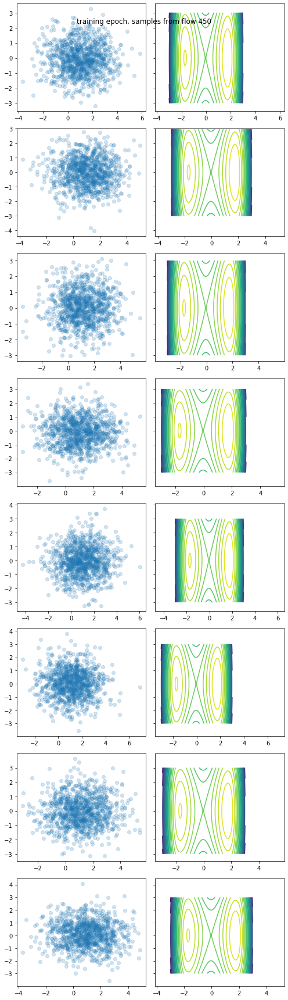

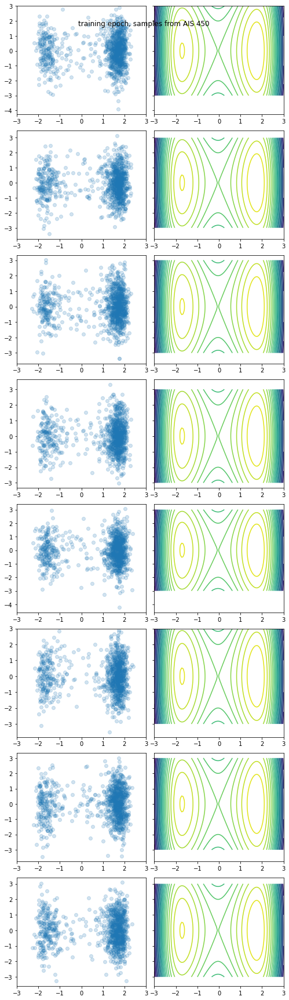

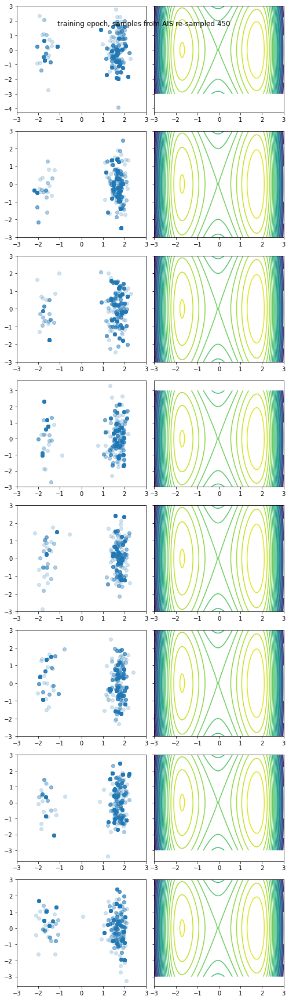

loss: 183.86688126322184,   log_p_x_post_AIS 63.02789574183141, ESS 0.025663864059698314:  35%|███▌      | 525/1500 [1:31:38<2:47:22, 10.30s/it]

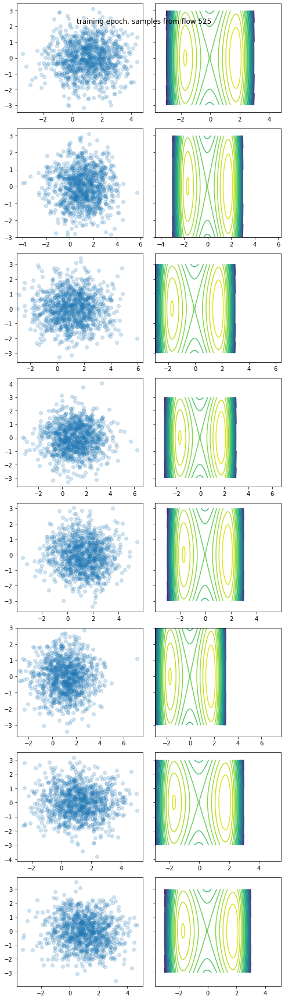

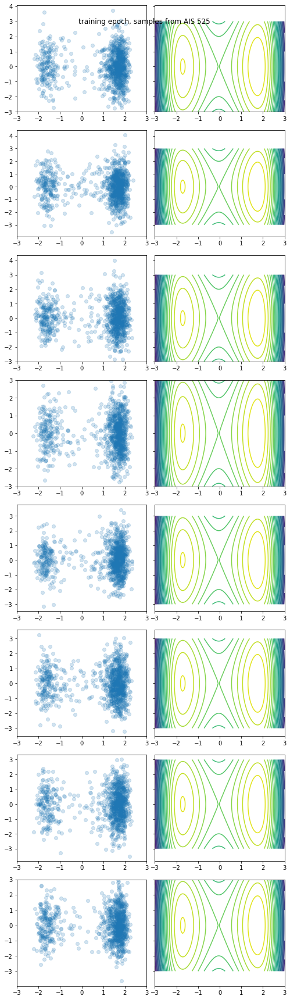

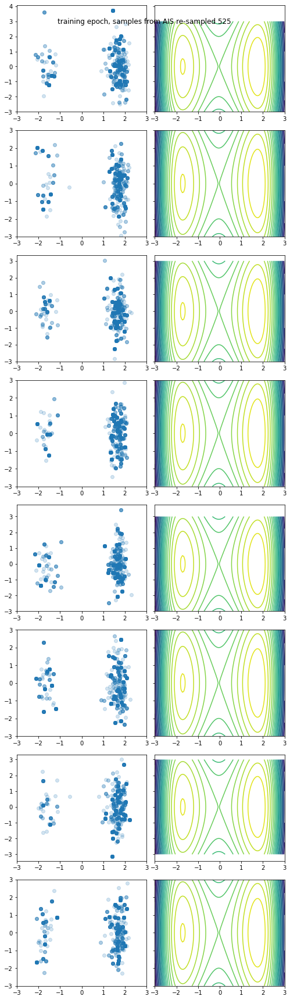

loss: 183.7385427907215,   log_p_x_post_AIS 63.118963986382234, ESS 0.02690200804611987:  40%|████      | 600/1500 [1:44:43<2:34:08, 10.28s/it]

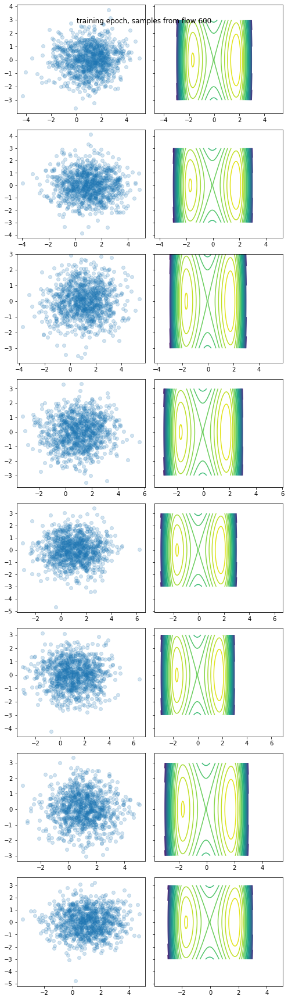

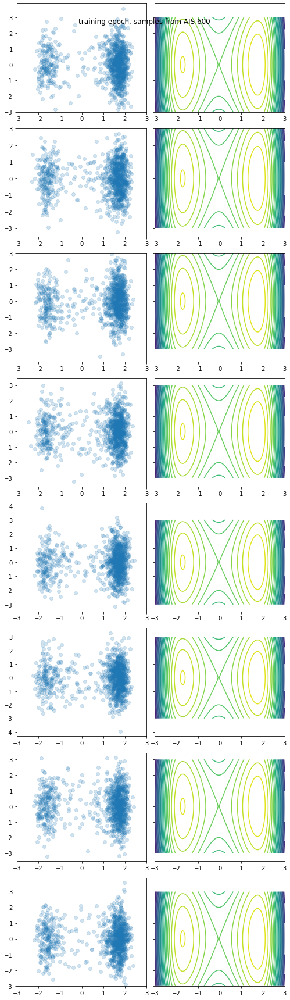

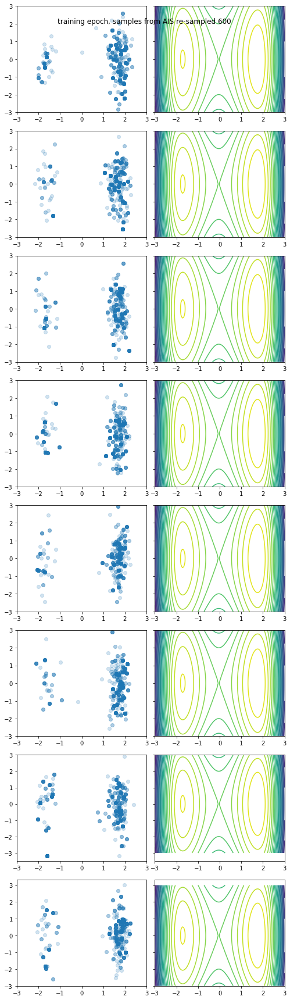

loss: 183.4806799689649,   log_p_x_post_AIS 63.27363996262205, ESS 0.031917343366417855:  45%|████▌     | 675/1500 [1:57:47<2:25:07, 10.55s/it] 

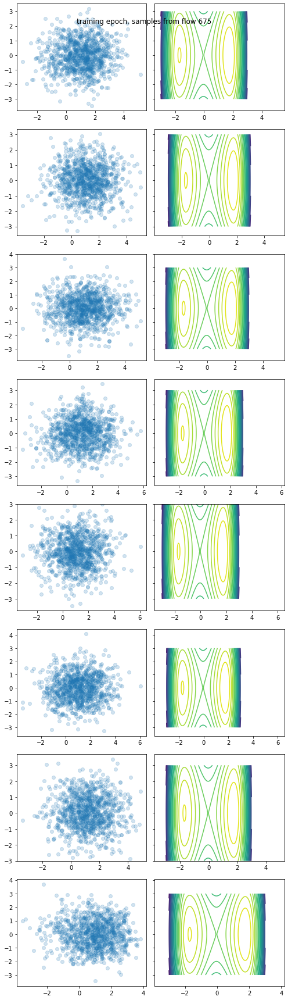

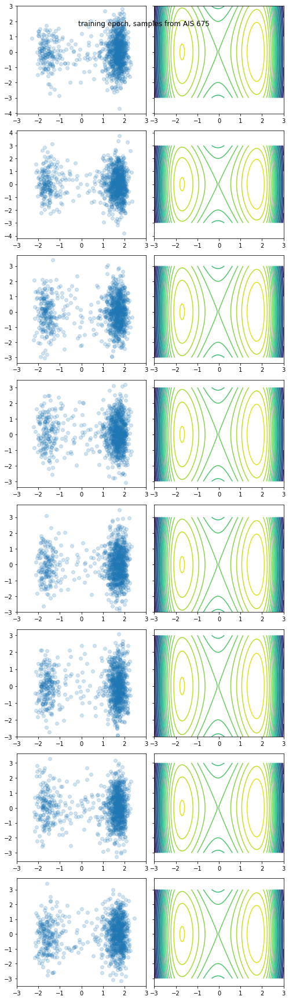

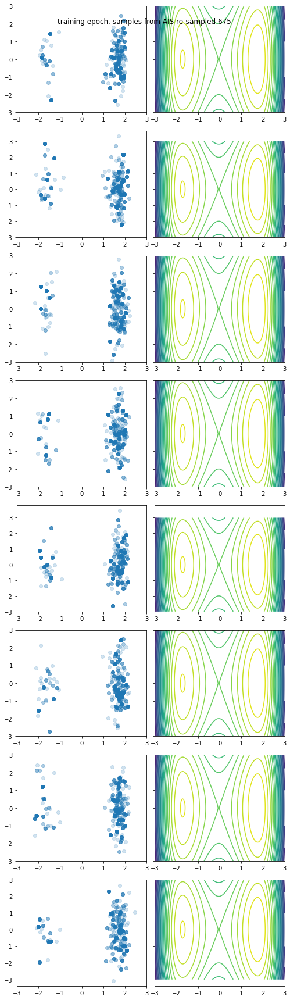

loss: 183.50792705701727,   log_p_x_post_AIS 63.315561395117136, ESS 0.026516258764312507:  50%|█████     | 750/1500 [2:10:53<2:08:29, 10.28s/it]

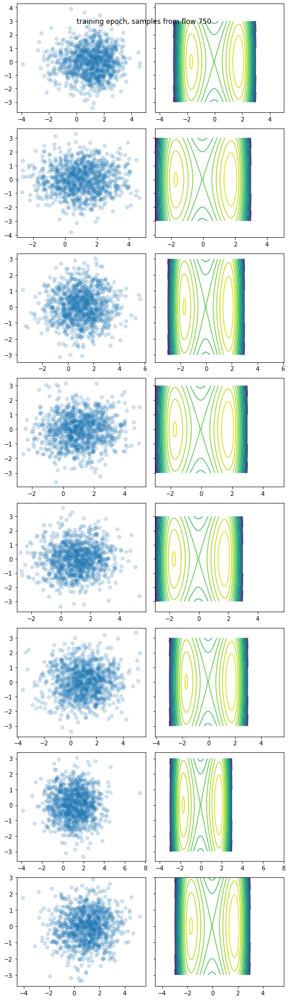

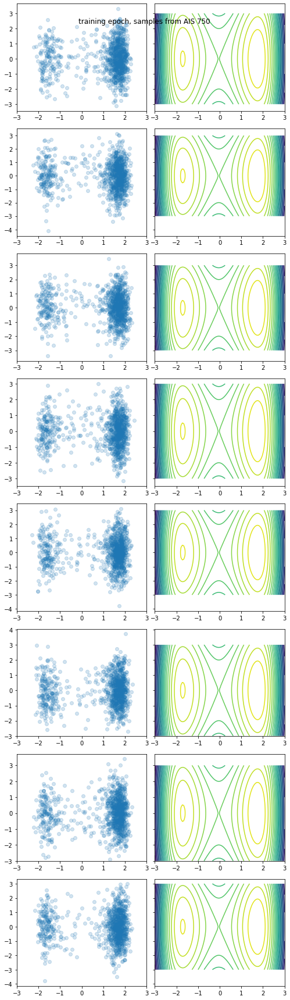

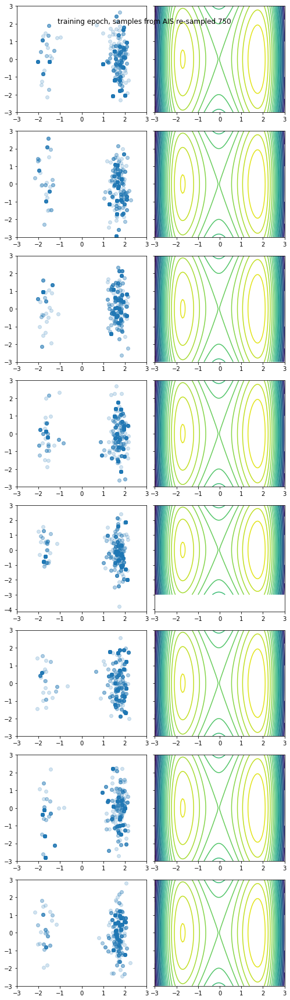

loss: 183.391332959004,   log_p_x_post_AIS 63.47857191969627, ESS 0.0332535189693458:  55%|█████▌    | 825/1500 [2:23:56<1:55:27, 10.26s/it]    

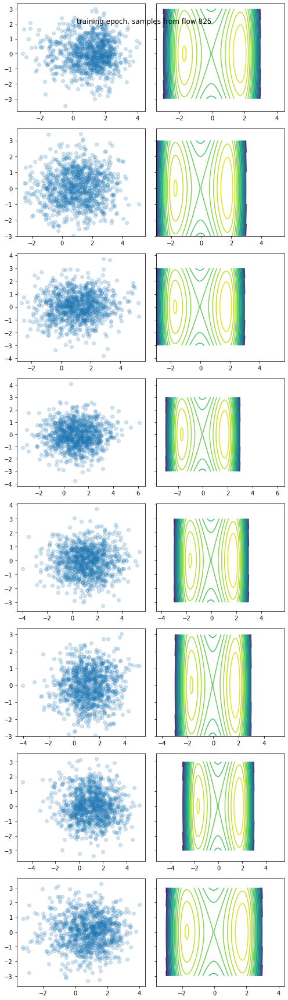

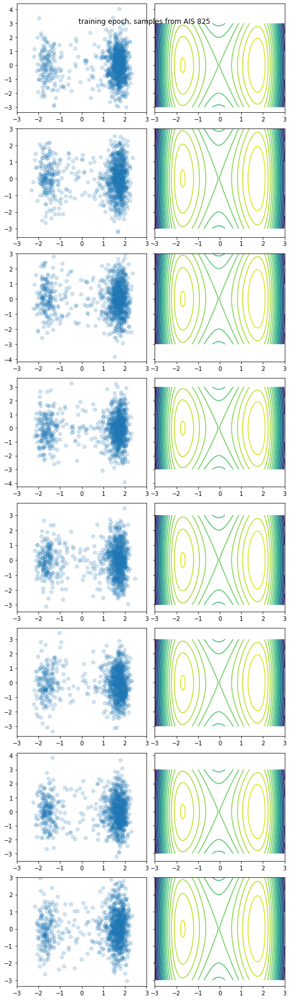

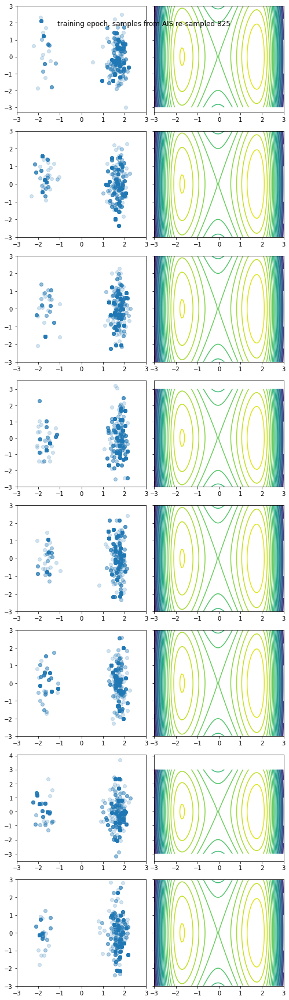

loss: 182.85295306453682,   log_p_x_post_AIS 63.41105211586126, ESS 0.03035675045026814:  60%|██████    | 900/1500 [2:37:02<1:43:07, 10.31s/it] 

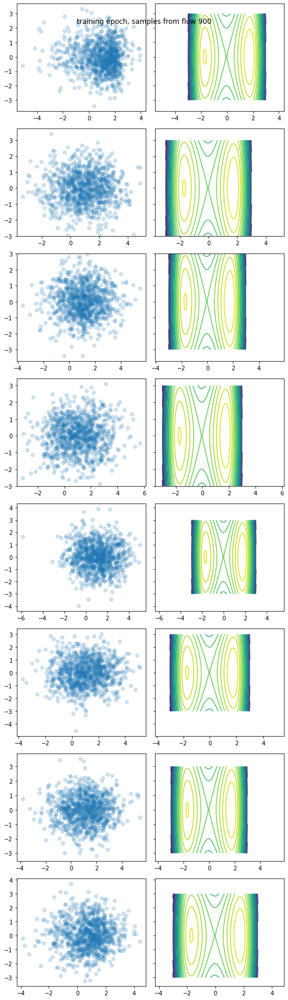

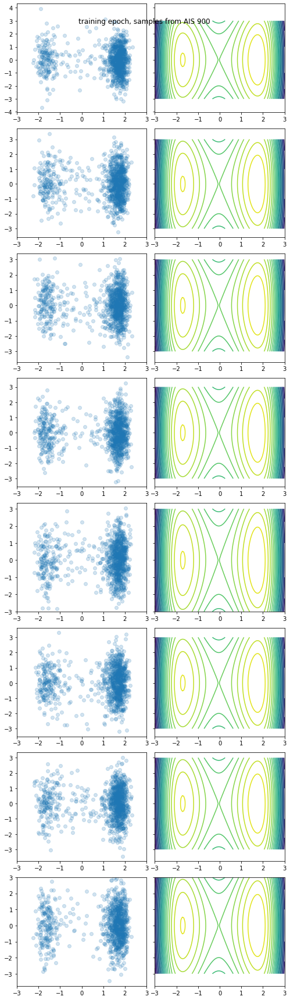

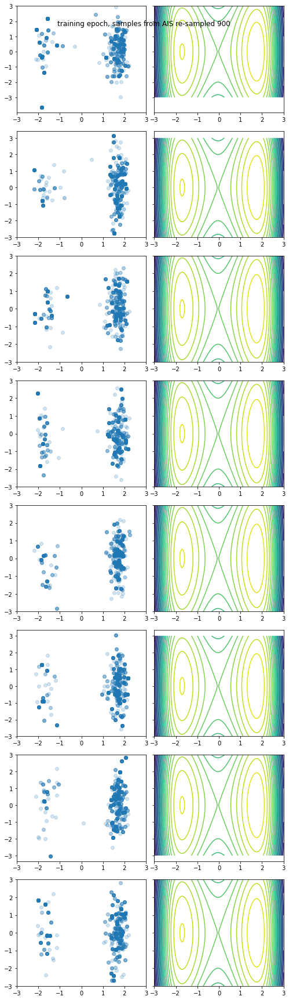

loss: 182.65770700612967,   log_p_x_post_AIS 63.2427063651803, ESS 0.025435179333933654:  65%|██████▌   | 975/1500 [2:50:08<1:30:31, 10.35s/it]

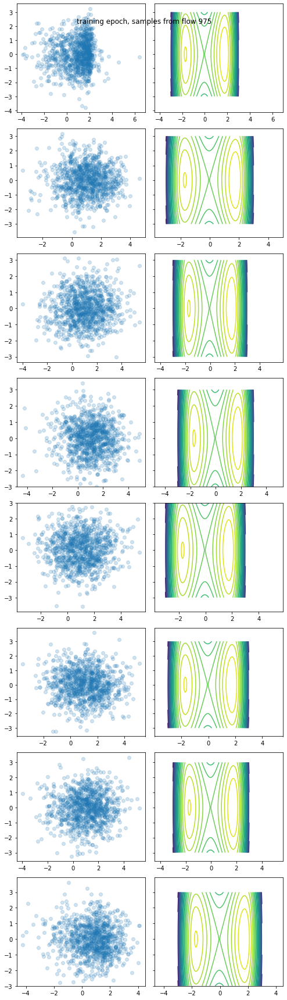

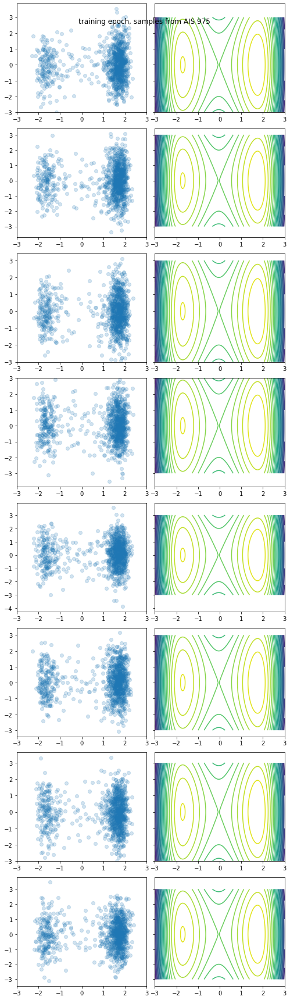

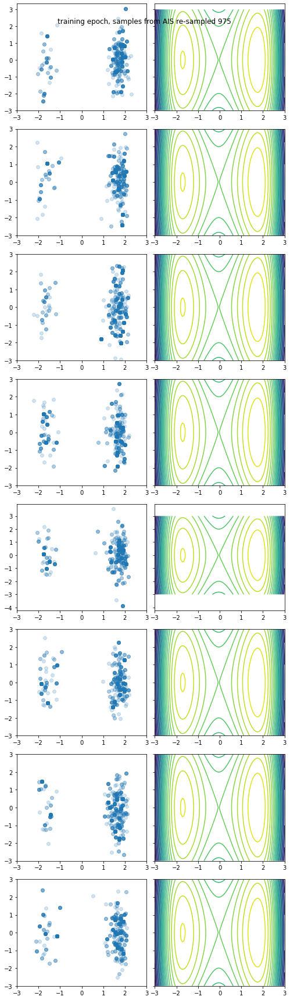

loss: 182.48285146664273,   log_p_x_post_AIS 63.150575321281245, ESS 0.028606779834484165:  70%|███████   | 1050/1500 [3:03:15<1:17:52, 10.38s/it]

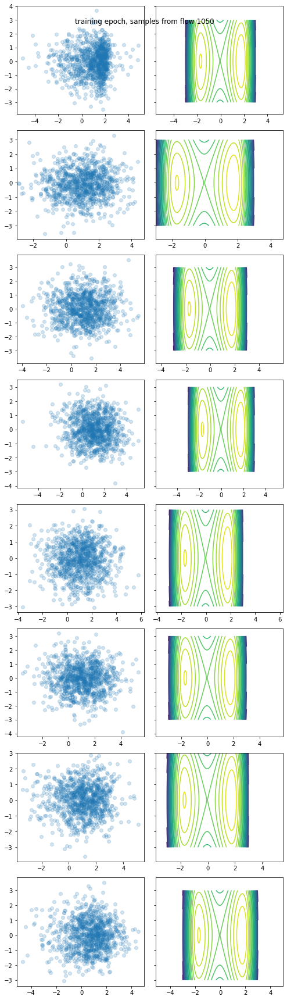

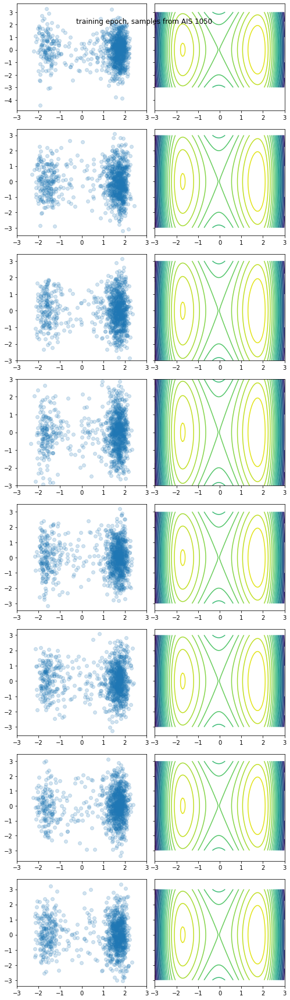

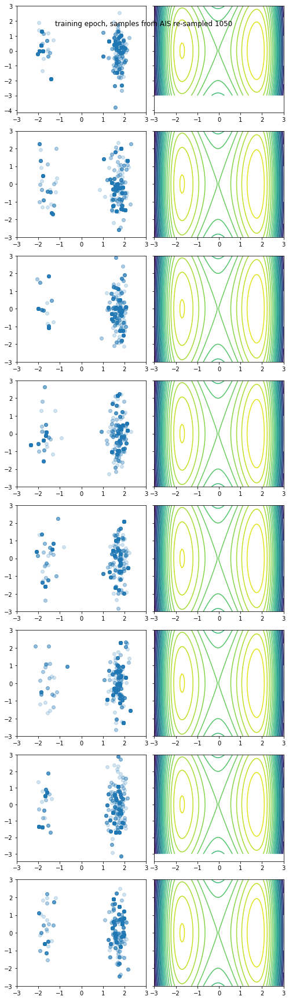

loss: 182.59355191415654,   log_p_x_post_AIS 63.51904517780756, ESS 0.030570490135522797:  75%|███████▌  | 1125/1500 [3:16:22<1:04:56, 10.39s/it]

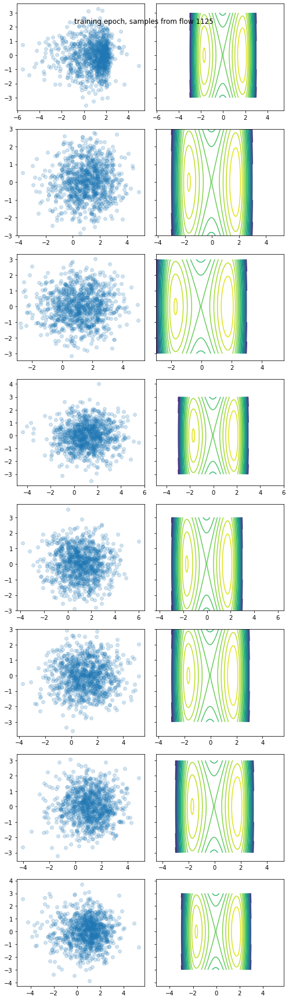

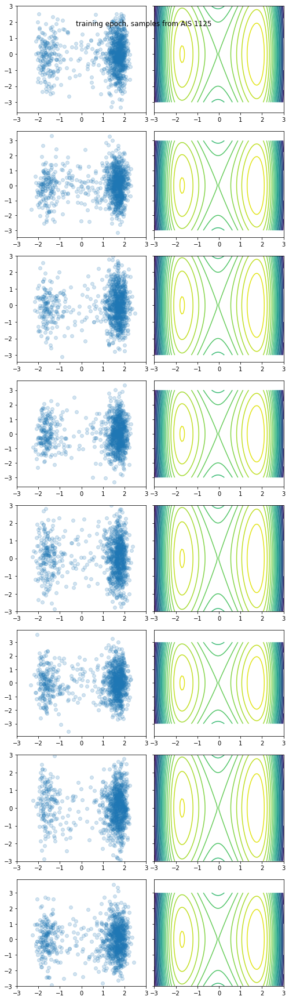

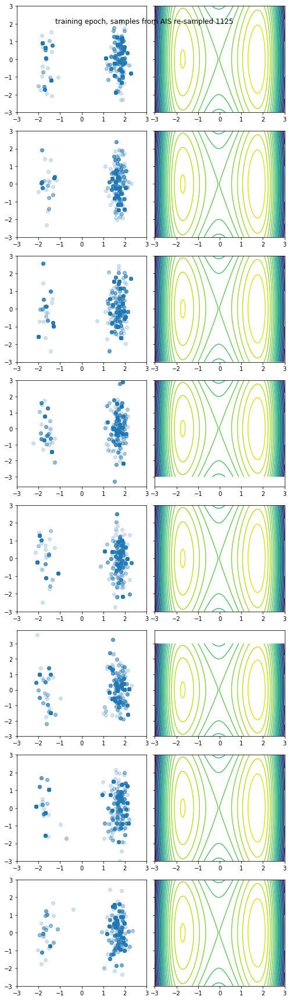

loss: 182.58948831808115,   log_p_x_post_AIS 63.401413860639, ESS 0.029574293308579233:  80%|████████  | 1200/1500 [3:29:30<51:45, 10.35s/it]

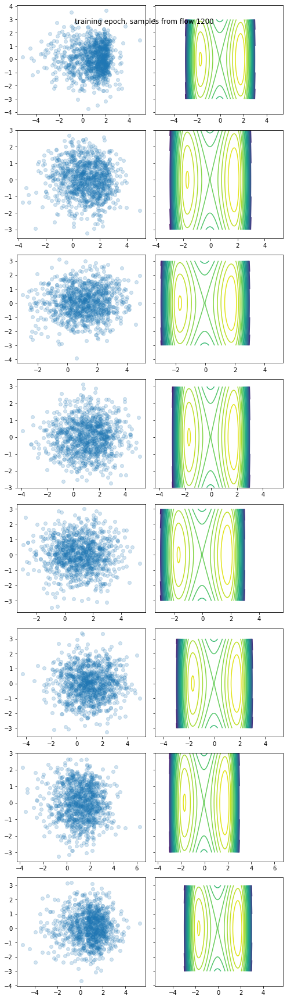

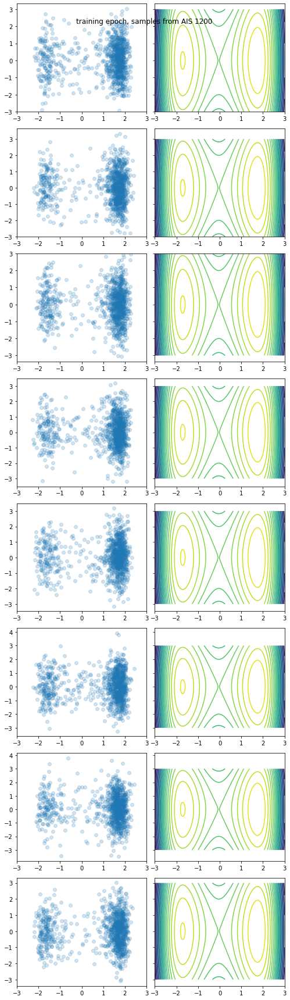

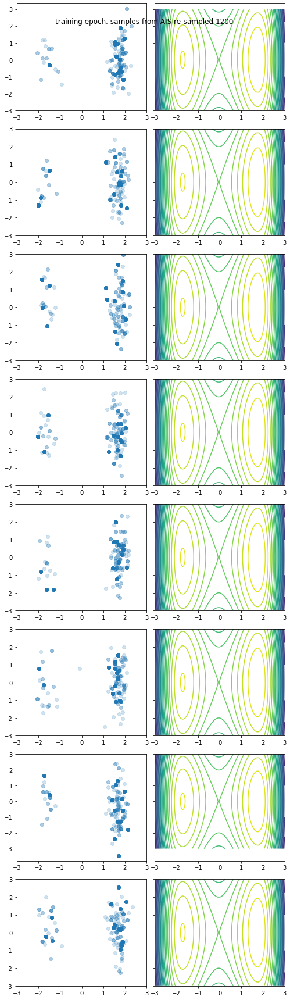

loss: 182.40437838543374,   log_p_x_post_AIS 63.46294160897662, ESS 0.03609742882930363:  85%|████████▌ | 1275/1500 [3:42:41<38:57, 10.39s/it] 

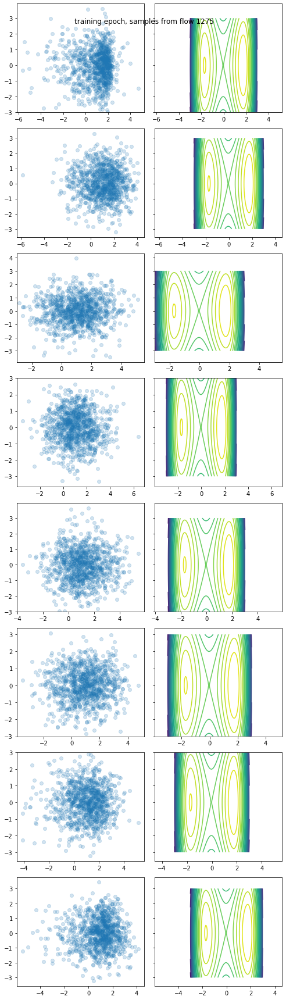

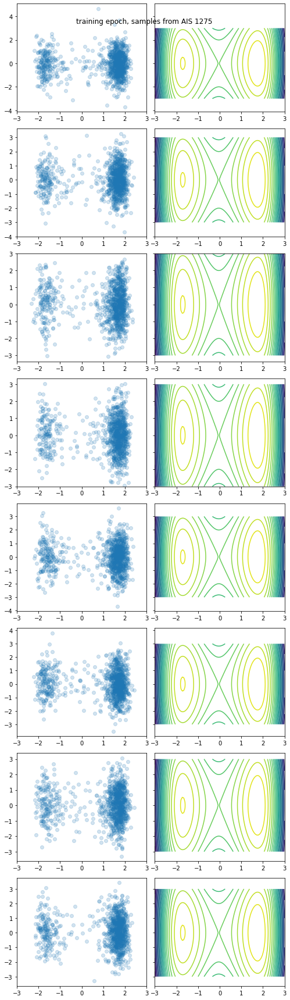

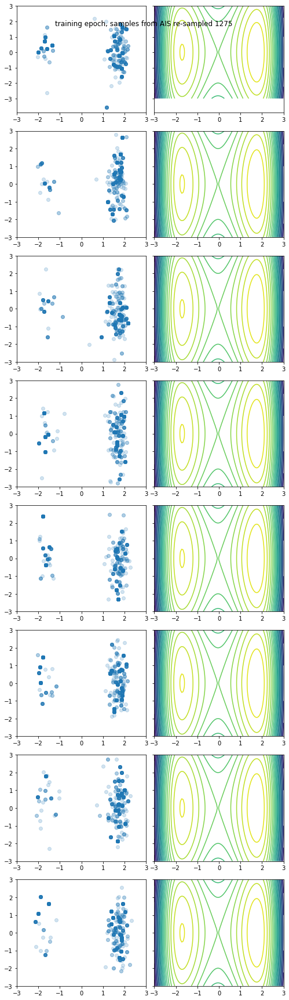

loss: 182.46124407500537,   log_p_x_post_AIS 63.58120617548575, ESS 0.029394045741610735:  90%|█████████ | 1350/1500 [3:55:51<25:56, 10.37s/it]

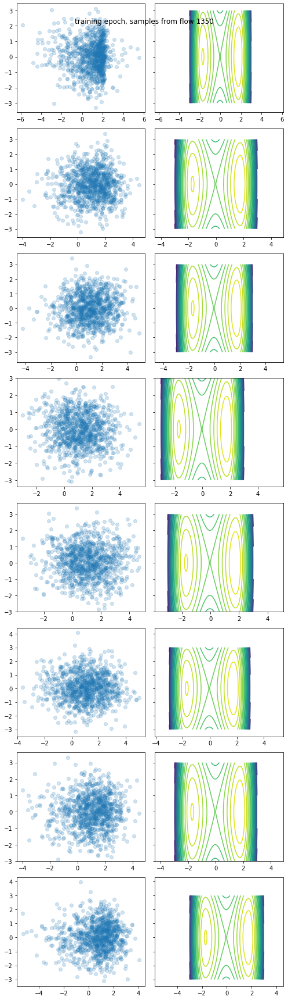

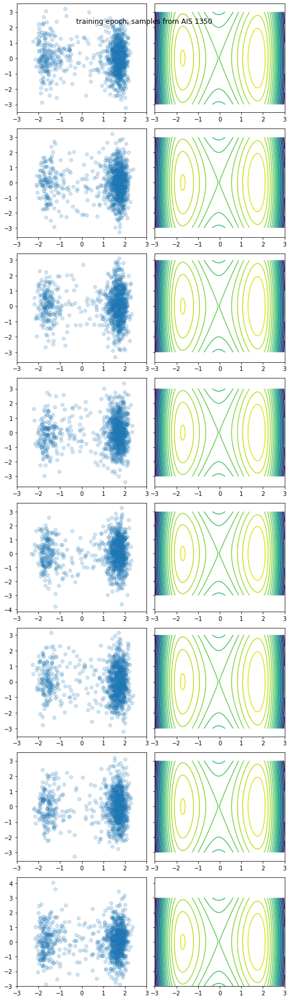

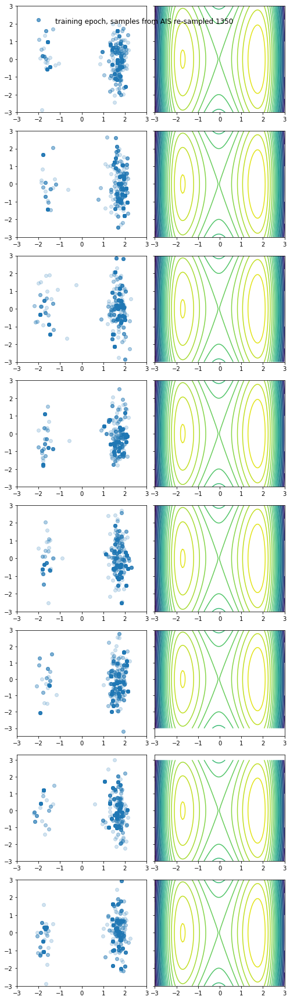

loss: 182.52075615800825,   log_p_x_post_AIS 63.549852405018704, ESS 0.029808589921275216:  95%|█████████▌| 1425/1500 [4:09:02<12:52, 10.31s/it]

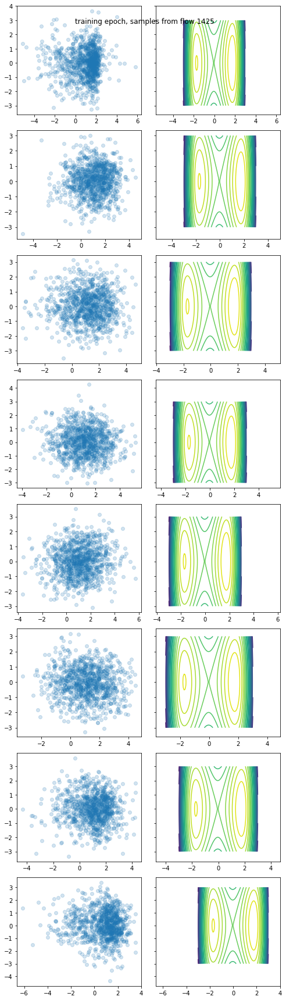

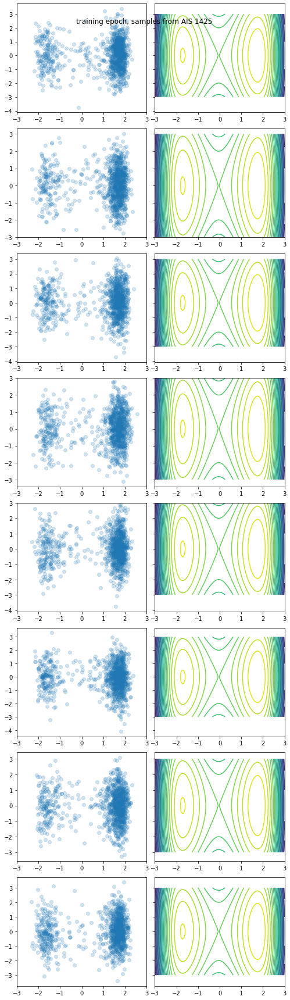

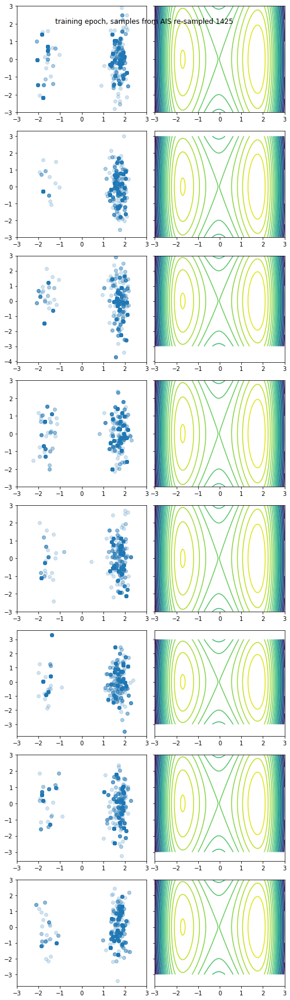

loss: 182.29266298628573,   log_p_x_post_AIS 63.591631770591334, ESS 0.02727387269522829: 100%|██████████| 1500/1500 [4:21:59<00:00, 10.48s/it]


In [11]:
history = tester.train(1500, batch_size=int(1e3), intermediate_plots=True, n_plots=20, plotting_func=plotter)

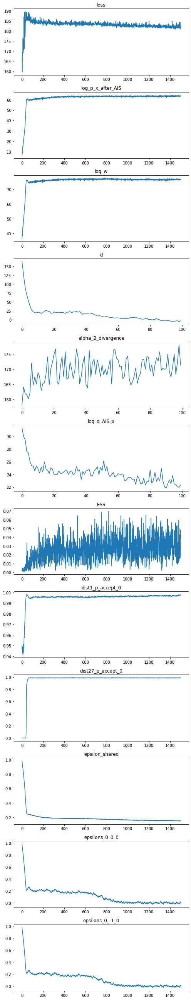

In [12]:
plot_history(history)

In [ ]:
expectation, info_dict = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict['effective_sample_size'].item() / info_dict["normalised_sampling_weights"].shape[0])

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict["samples"])

In [ ]:
expectation_flo, info_dict_flo = tester.AIS_train.calculate_expectation_over_flow(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict_flo['effective_sample_size'].item() / info_dict_flo["normalised_sampling_weights"].shape[0])

# Another Iter

In [ ]:
history = tester.train(2000, batch_size=int(1e3), intermediate_plots=True, n_plots=10, plotting_func=plotter)

In [ ]:
plot_history(history)

In [ ]:
plot_history(dict([(key, history[key]) for key in ('loss', 'log_p_x_after_AIS', 'log_w', 'kl', 
                                               'alpha_2_divergence', 'log_q_AIS_x', 'ESS')]))

In [ ]:
expectation, info_dict = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict['effective_sample_size'].item() / info_dict["normalised_sampling_weights"].shape[0])

In [ ]:
expectation_flo, info_dict_flo = tester.AIS_train.calculate_expectation_over_flow(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(2e3),
                                                               drop_nan_and_infs=True)
print(info_dict_flo['effective_sample_size'].item() / info_dict_flo["normalised_sampling_weights"].shape[0])

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict["samples"])